
# Preprocessing - Doublet Detection - E15-5

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
import os

#R
import rpy2
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
import seaborn as sb

# Analysis
import scanpy as sc
import scanpy.external as sce
import scrublet as scr
import doubletdetection

In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_versions()

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.8
scanpy      1.8.2
sinfo       0.3.4
-----
PIL                         8.4.0
anndata2ri                  1.0.6
anyio                       NA
attr                        21.2.0
babel                       2.9.1
backcall                    0.2.0
backports                   NA
beta_ufunc                  NA
binom_ufunc                 NA
bottleneck                  1.3.2
certifi                     2021.10.08
cffi                        1.15.0
chardet                     4.0.0
charset_norm

In [4]:
%%R

library(tidyverse)
library(Signac)
library(Seurat)

# Parallelization
library(BiocParallel)
register(MulticoreParam(32, progressbar = TRUE))

sessionInfo()

R version 4.1.1 (2021-08-10)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS/LAPACK: /home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/libopenblasp-r0.3.18.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] tools     stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] BiocParallel_1.26.2 SeuratObject_4.0.2  Seurat_4.0.4       
 [4] Signac_1.4.0        forcats_0.5.1       stringr_1.4.0      
 [7] dplyr_1.0.7         purrr_0.3.4         readr_2.0.1        
[10] tidyr_1.1.3         tibble_3.1.4        ggplot2_3.3.5      
[13] tidyverse_1.3.1  

In [5]:
# Color maps
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())

In [6]:
# Plot settings
%matplotlib inline

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

# Load Data

In [7]:
adata_multi=sc.read('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered.h5ad')
adata=sc.read('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_gex_bc_matrix_filtered.h5ad')

In [8]:
adata.shape

(7784, 24784)

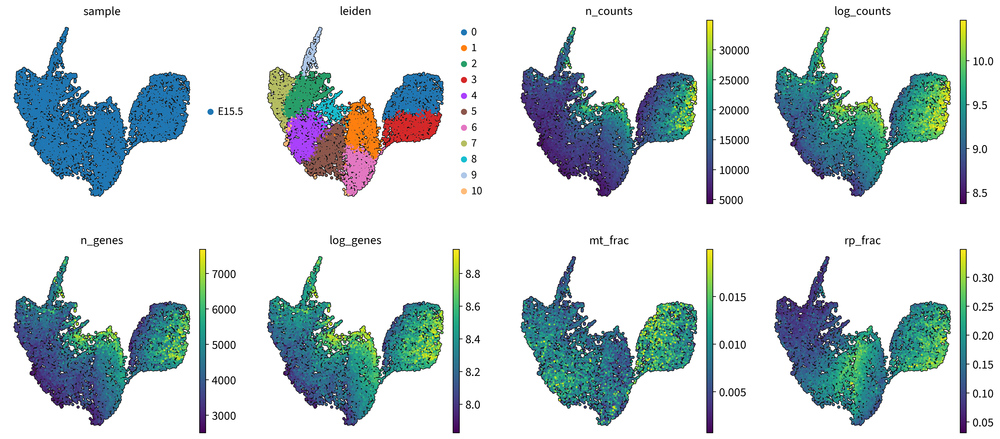

In [9]:
sc.pl.umap(adata, color=['sample','leiden','n_counts','log_counts','n_genes','log_genes','mt_frac','rp_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

# Doublet Identification

## Scrublet

In [10]:
adata.obs['scrublet_scores']=0
adata.obs['scrublet_doublets']=False

In [11]:
# filtering/preprocessing parameters:
min_counts = 2
min_cells = 3
variability_pctl = 85
n_pc = 50

# doublet detector parameters:
expected_doublet_rate = 0.12 
sim_doublet_ratio = 5

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.76
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 5.7%
Overall doublet rate:
	Expected   = 12.0%
	Estimated  = 7.7%
Elapsed time: 19.0 seconds


2022-02-26 01:56:39.516812: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


Elapsed time: 40.8 seconds


(<Figure size 1200x450 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

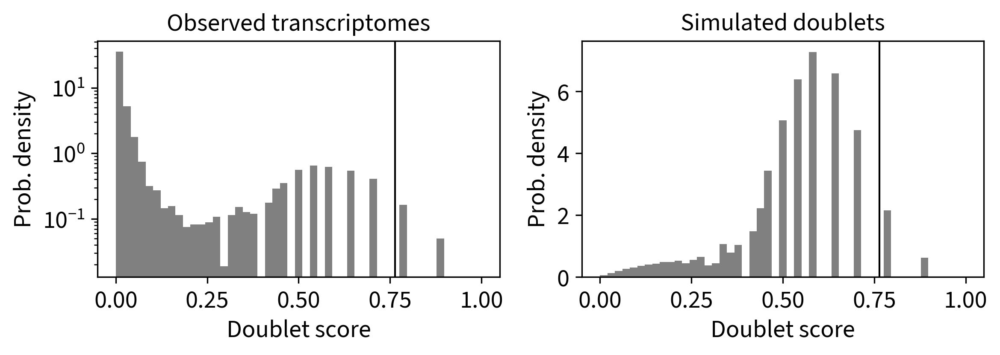

In [12]:
t0 = time.time()

scrub = scr.Scrublet(adata.X, expected_doublet_rate=expected_doublet_rate, sim_doublet_ratio=sim_doublet_ratio)
adata.obs['scrublet_scores'], adata.obs['scrublet_doublets'] = scrub.scrub_doublets(min_counts=min_counts, 
                                                                                          min_cells=min_cells, 
                                                                                          min_gene_variability_pctl=variability_pctl, 
                                                                                          n_prin_comps=n_pc,
                                                                                          log_transform=True,
                                                                                          mean_center=True,
                                                                                          normalize_variance=True
                                                                                         )
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))

t1 = time.time()
print('Elapsed time: {:.1f} seconds'.format(t1 - t0))

scrub.plot_histogram()
#scrub.plot_embedding('UMAP', order_points=True)

Detected doublet rate = 8.4%
Estimated detectable doublet fraction = 86.5%
Overall doublet rate:
	Expected   = 12.0%
	Estimated  = 9.7%


(<Figure size 1200x450 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

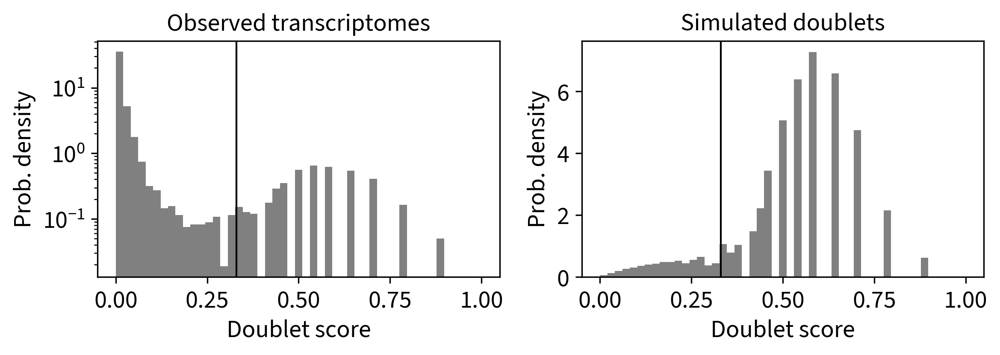

In [13]:
adata.obs['scrublet_doublets'] = scrub.call_doublets(threshold=0.33)
scrub.plot_histogram()
#scrub.plot_embedding('UMAP', order_points=True)

In [14]:
adata.obs['scrublet_doublets_cat'] = adata.obs['scrublet_doublets'].astype(str).astype('category')

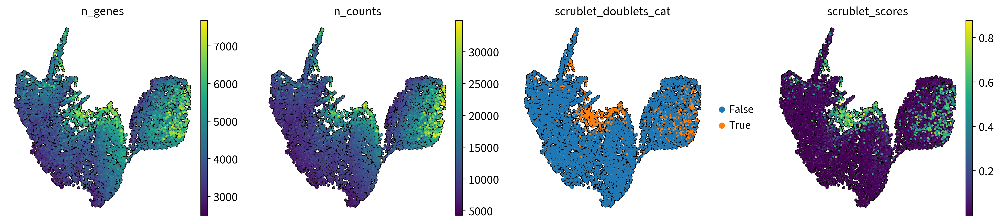

In [15]:
sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_doublets_cat','scrublet_scores'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

## Doublet Detection

In [16]:
adata.obs['dd_doublets']=0
adata.obs['dd_scores']=0
adata.obs['dd_log_p_values']=0
adata.obs['dd_voting_average']=0

In [17]:
with open('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E15-5_DoubletDetection_clf.pkl', 'rb') as file:
    adata_clf = pickle.load(file)
    
with open('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E15-5_DoubletDetection_dd_doublets.pkl', 'rb') as file:
    adata_dd_doublets = pickle.load(file)

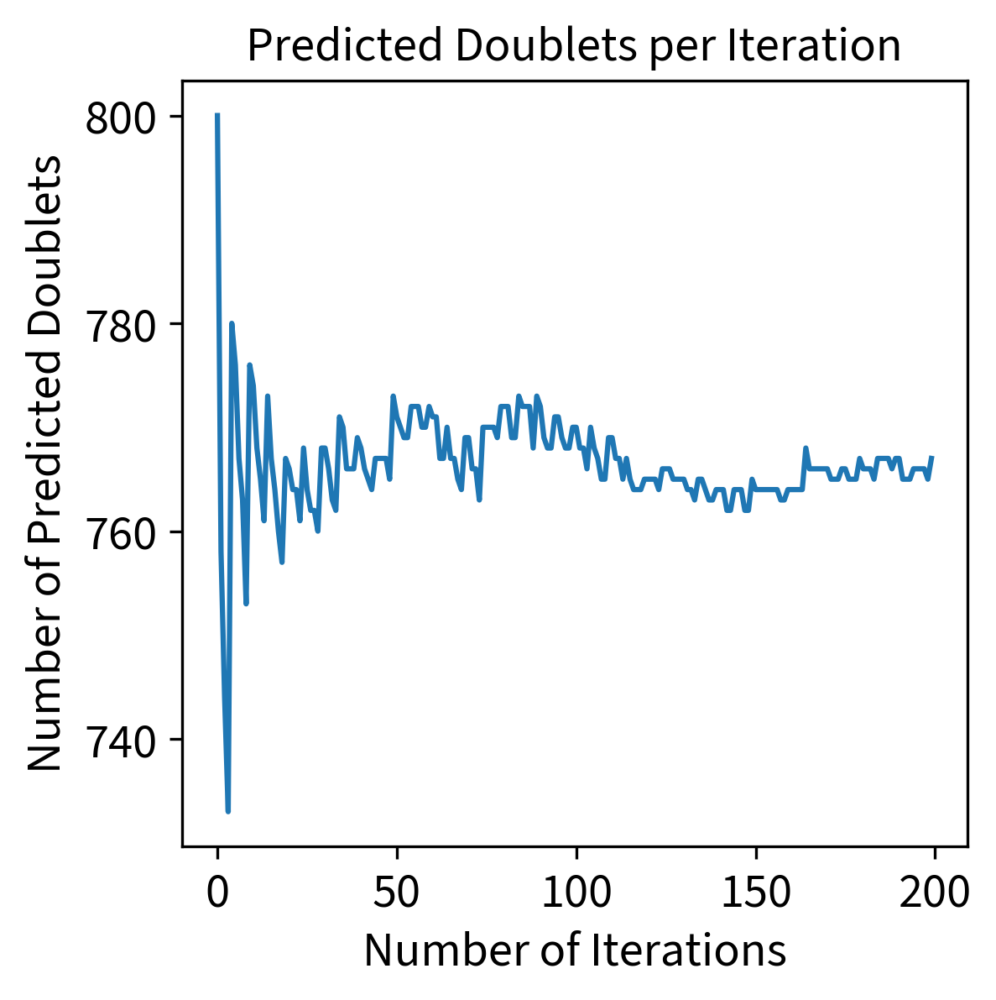

In [18]:
plot=doubletdetection.plot.convergence(adata_clf, show=False, p_thresh=1e-6, voter_thresh=0.8)

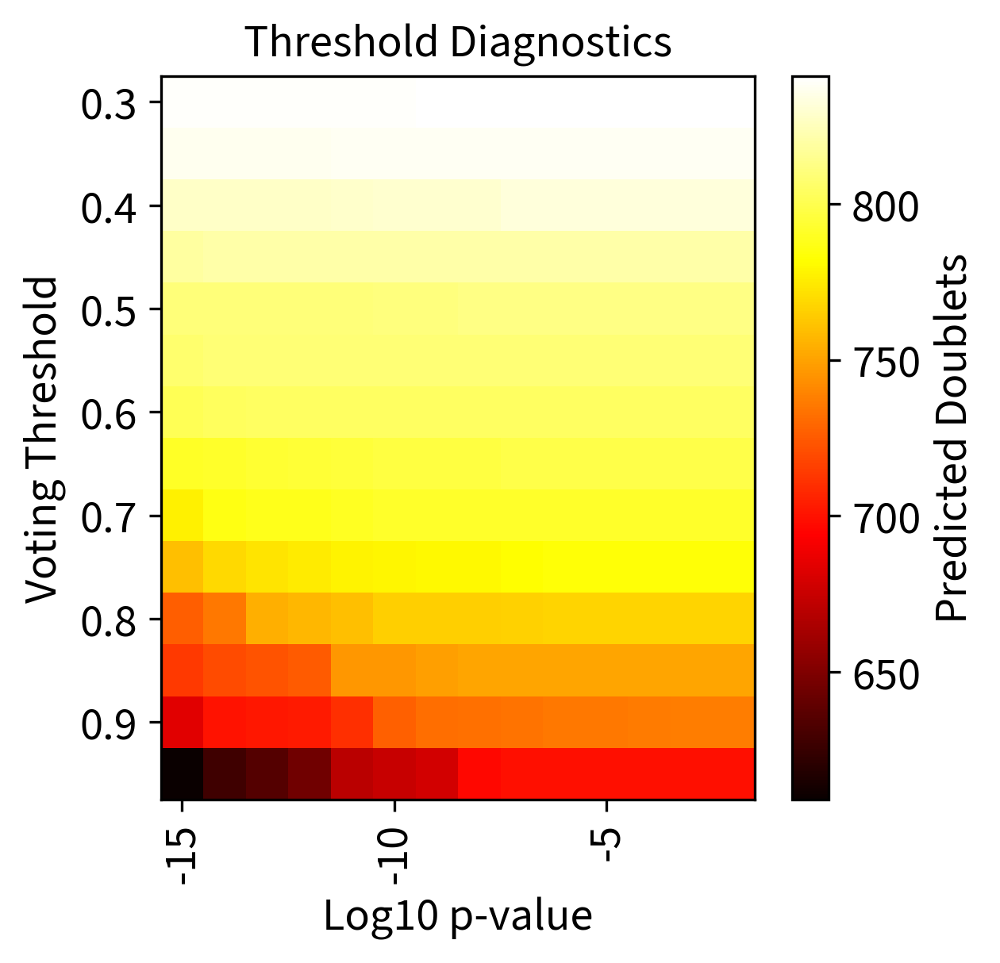

In [19]:
plot=doubletdetection.plot.threshold(adata_clf, show=True, p_step=5, log_p_grid=np.arange(-15, -1))

In [20]:
adata.obs['dd_doublets']=adata_dd_doublets.astype('bool')
adata.obs['dd_-log_p_values']=np.mean(adata_clf.all_log_p_values_, axis=0) * -1
adata.obs['dd_voting_average']=adata_clf.voting_average_
adata.obs['dd_scores']=np.mean(adata_clf.all_scores_, axis=0)

In [21]:
adata.obs['dd_doublets_cat'] = adata.obs['dd_doublets'].astype(str).astype('category')

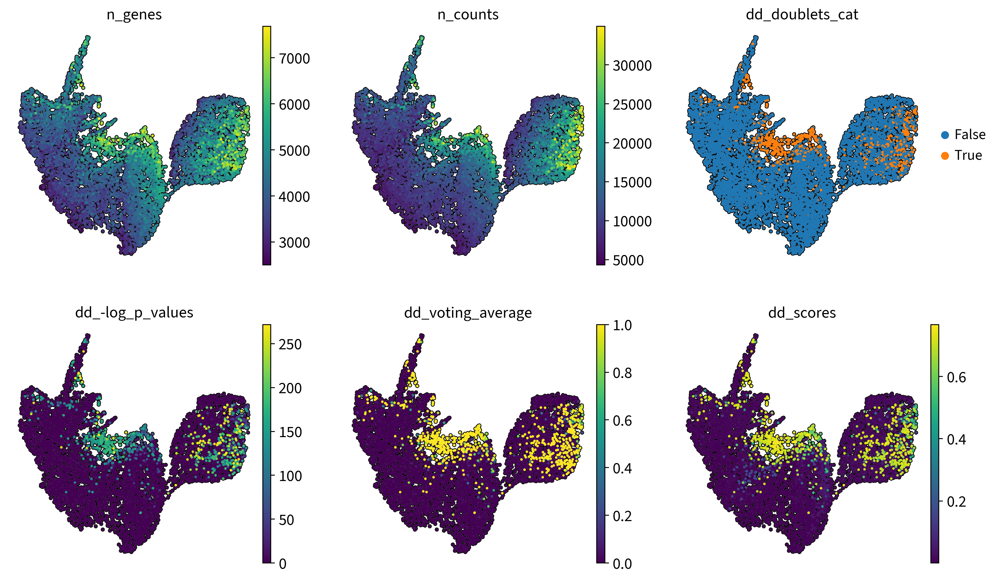

In [22]:
sc.pl.umap(adata, color=['n_genes','n_counts','dd_doublets_cat','dd_-log_p_values','dd_voting_average','dd_scores'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=3)

In [23]:
print('DoubletDetection doublet rate:', adata.obs['dd_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['dd_doublets'].value_counts()[1],' cells)' )

DoubletDetection doublet rate: 9.853545734840699 % ( 767  cells)


## DoubletFinder

In [24]:
adata_DoubletFinder = pd.read_table('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/DoubletFinder/E15-5_raw_gex_bc_matrix_filtered_DoubletFinder.txt', delimiter='\t')

adata.obs = pd.merge(adata.obs,adata_DoubletFinder, left_index=True, right_index=True)

/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DF_classifications_1' as categorical
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DF_classifications_2' as categorical


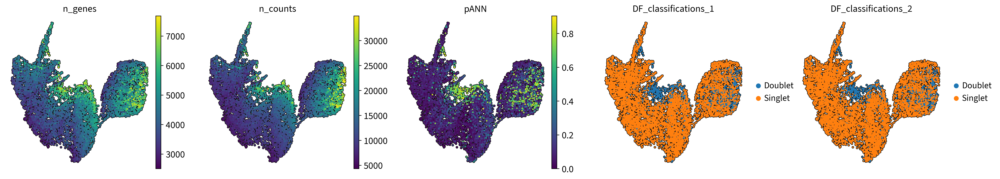

In [25]:
sc.pl.umap(adata, color=['n_genes','n_counts','pANN','DF_classifications_1','DF_classifications_2'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

In [26]:
adata_DoubletFinder_SCT = pd.read_table('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/DoubletFinder/E15-5_raw_gex_bc_matrix_filtered_DoubletFinder_SCT.txt', delimiter='\t')

adata.obs = pd.merge(adata.obs,adata_DoubletFinder_SCT, left_index=True, right_index=True)

/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DF_SCT_classifications_1' as categorical
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DF_SCT_classifications_2' as categorical


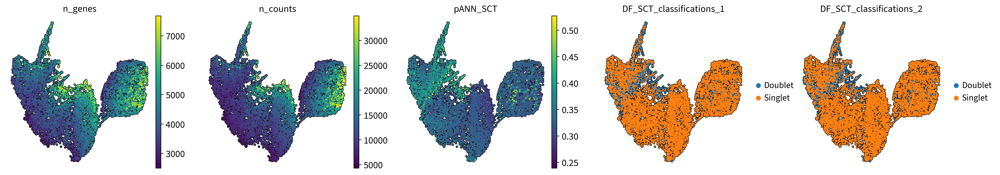

In [27]:
sc.pl.umap(adata, color=['n_genes','n_counts','pANN_SCT','DF_SCT_classifications_1','DF_SCT_classifications_2'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

In [28]:
adata.obs.loc[:,'df_doublets'] = False
adata.obs.loc[adata.obs.loc[:,'DF_classifications_1']=='Doublet','df_doublets'] = True
adata.obs.loc[adata.obs.loc[:,'DF_SCT_classifications_1']=='Doublet','df_doublets'] = True

In [29]:
print('DoubletFinder doublet rate: ', adata.obs['df_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['df_doublets'].value_counts()[1],' cells)' )

DoubletFinder doublet rate:  17.124871531346354 % ( 1333  cells)


## scDblFinder & scds Hybrid Score

In [30]:
adata_scDblFinder = pd.read_table('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/DoubletFinder/E15-5_raw_gex_bc_matrix_filtered_scDblFinder_scds.txt', delimiter='\t')

adata.obs = pd.merge(adata.obs,adata_scDblFinder, left_index=True, right_index=True)

/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'scDblFinder.class' as categorical
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'hybrid_class' as categorical


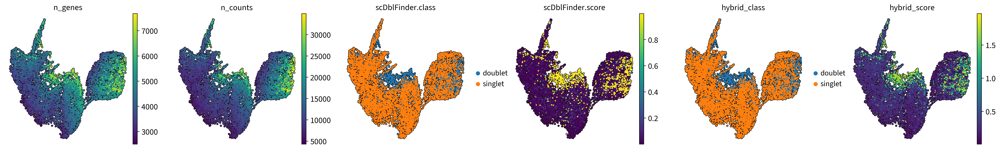

In [31]:
sc.pl.umap(adata, color=['n_genes','n_counts','scDblFinder.class','scDblFinder.score','hybrid_class','hybrid_score'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

In [32]:
print('Scds doublet rate:', (adata.obs['hybrid_class'] == 'doublet').value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_class'] == 'doublet').value_counts()[1],' cells)' )
print('Cut-off:', min(adata[adata.obs['hybrid_class'] == 'doublet'].obs['hybrid_score']))

Scds doublet rate: 12.076053442959918 % ( 940  cells)
Cut-off: 0.556036505937233


Scds doublet rate: 8.581706063720453 % ( 668  cells)


/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


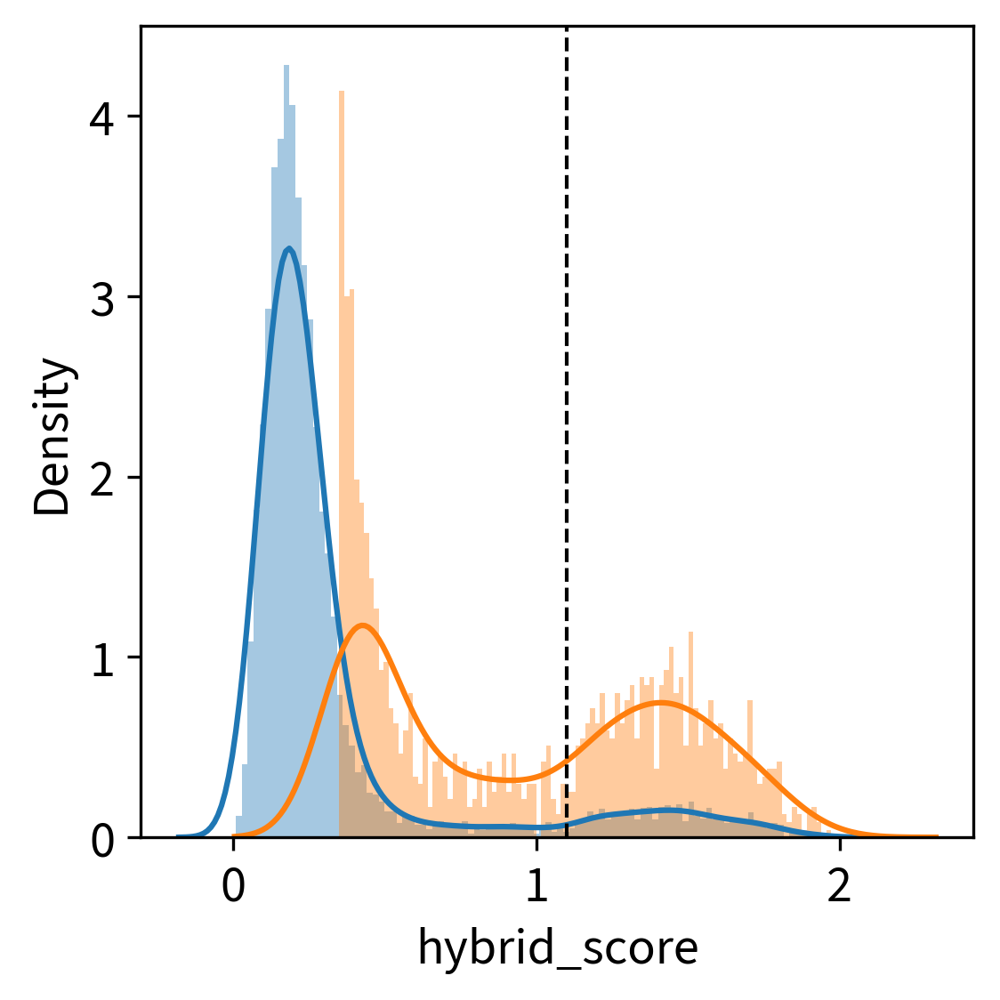

In [33]:
# Adjust cut-off as doublet rate is too high 
cut_off = 1.1 #min(adata[adata.obs['hybrid_class'] == 'doublet'].obs['hybrid_score'])

sb.distplot(adata.obs['hybrid_score'], kde=True, bins=100)
sb.distplot(adata.obs['hybrid_score'][(adata.obs['hybrid_score']>0.35) & (adata.obs['hybrid_score']<2)], kde=True, bins=100)
plt.axvline(cut_off, 0, 1, color="black", lw=1).set_linestyle("--")

print('Scds doublet rate:', (adata.obs['hybrid_score'] > cut_off).value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_score'] > cut_off).value_counts()[1],' cells)' )

In [34]:
adata.obs['hybrid_class'] = pd.Categorical(adata.obs['hybrid_class'], categories=['doublet','singlet'])
adata.obs.loc[adata.obs.loc[:,'hybrid_score'] < cut_off,'hybrid_class'] = 'singlet'

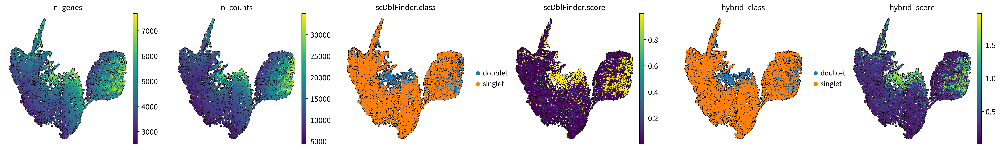

In [35]:
sc.pl.umap(adata, color=['n_genes','n_counts','scDblFinder.class','scDblFinder.score','hybrid_class','hybrid_score'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

In [36]:
adata_scDblFinder_SCT = pd.read_table('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/DoubletFinder/E15-5_raw_gex_bc_matrix_filtered_scDblFinder_scds_SCT.txt', delimiter='\t')

adata.obs = pd.merge(adata.obs,adata_scDblFinder_SCT, left_index=True, right_index=True)

/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'scDblFinder.class.sct' as categorical
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'hybrid_class_sct' as categorical


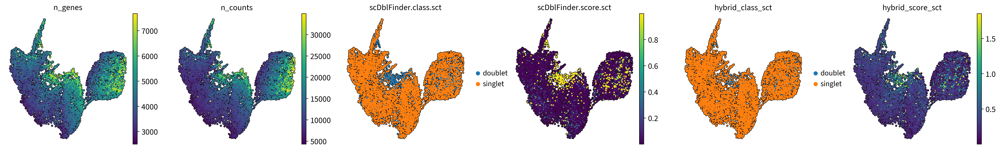

In [37]:
sc.pl.umap(adata, color=['n_genes','n_counts','scDblFinder.class.sct','scDblFinder.score.sct','hybrid_class_sct','hybrid_score_sct'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

In [38]:
print('Scds doublet rate:', (adata.obs['hybrid_class_sct'] == 'doublet').value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_class_sct'] == 'doublet').value_counts()[1],' cells)' )
print('Cut-off:', min(adata[adata.obs['hybrid_class_sct'] == 'doublet'].obs['hybrid_score_sct']))

Scds doublet rate: 2.5051387461459402 % ( 195  cells)
Cut-off: 0.77661208878203


Scds doublet rate: 9.72507708119219 % ( 757  cells)


/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


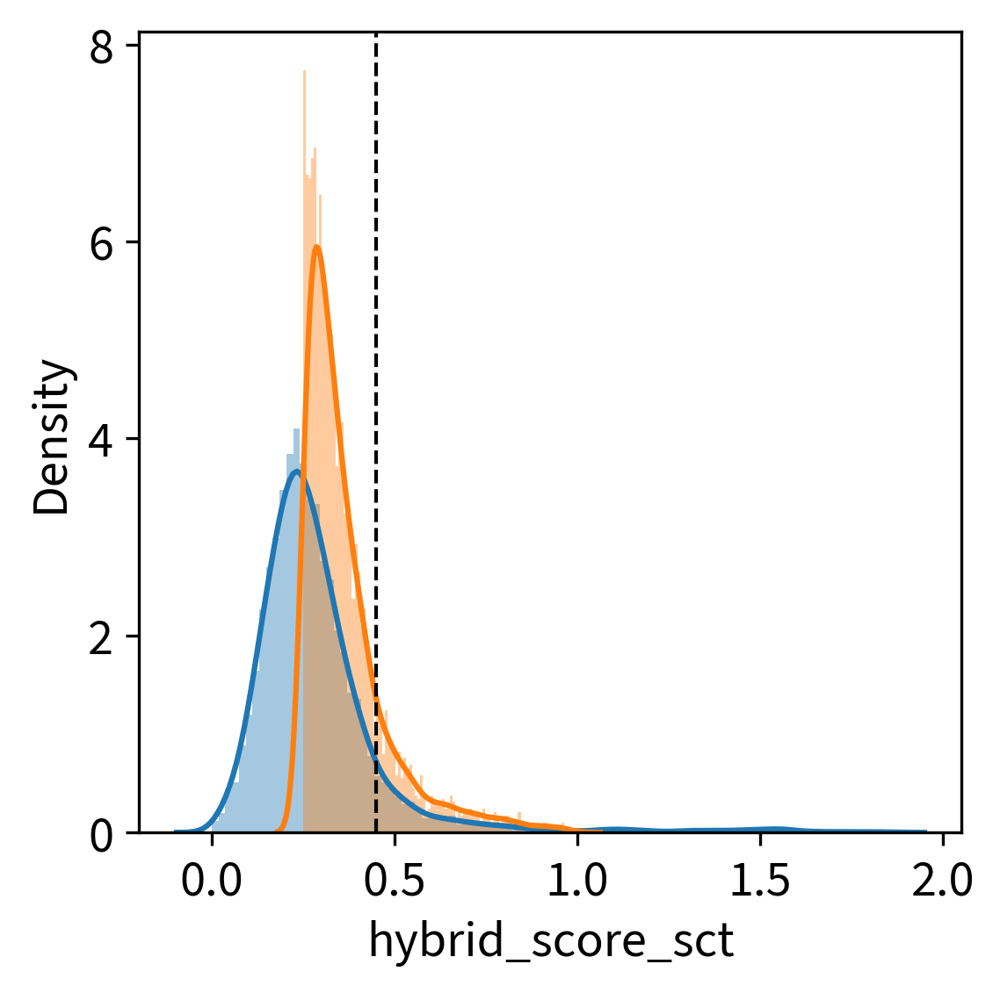

In [39]:
# Adjust cut-off as doublet rate is too high 
cut_off = 0.45 #min(adata[adata.obs['hybrid_class_sct'] == 'doublet'].obs['hybrid_score_sct'])

sb.distplot(adata.obs['hybrid_score_sct'], kde=True, bins=100)
sb.distplot(adata.obs['hybrid_score_sct'][(adata.obs['hybrid_score_sct']>0.25) & (adata.obs['hybrid_score_sct']<1)], kde=True, bins=100)
plt.axvline(cut_off, 0, 1, color="black", lw=1).set_linestyle("--")

print('Scds doublet rate:', (adata.obs['hybrid_score_sct'] > cut_off).value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',(adata.obs['hybrid_score_sct'] > cut_off).value_counts()[1],' cells)' )

In [40]:
adata.obs['hybrid_class_sct'] = pd.Categorical(adata.obs['hybrid_class_sct'], categories=['doublet','singlet'])
adata.obs.loc[adata.obs.loc[:,'hybrid_score_sct'] < cut_off,'hybrid_class_sct'] = 'singlet'

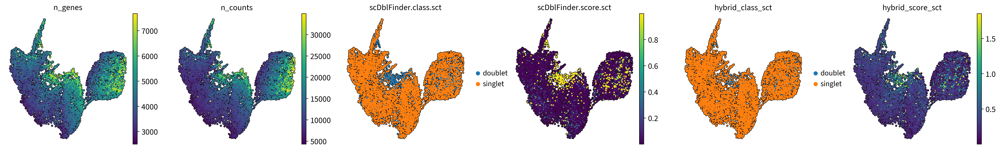

In [41]:
sc.pl.umap(adata, color=['n_genes','n_counts','scDblFinder.class.sct','scDblFinder.score.sct','hybrid_class_sct','hybrid_score_sct'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

In [42]:
adata.obs.loc[:,'sdf_doublets'] = False
adata.obs.loc[adata.obs.loc[:,'scDblFinder.class']=='doublet','sdf_doublets'] = True
adata.obs.loc[adata.obs.loc[:,'scDblFinder.class.sct']=='doublet','sdf_doublets'] = True

adata.obs.loc[:,'scds_doublets'] = False
adata.obs.loc[adata.obs.loc[:,'hybrid_class']=='doublet','scds_doublets'] = True
adata.obs.loc[adata.obs.loc[:,'hybrid_class_sct']=='doublet','scds_doublets'] = True

In [43]:
print('scDblFinder doublet rate:', adata.obs['sdf_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['sdf_doublets'].value_counts()[1],' cells)' )
print('Scds doublet rate:', adata.obs['scds_doublets'].value_counts()[1]/adata.obs['sample'].value_counts()[0]*100, '% (',adata.obs['scds_doublets'].value_counts()[1],' cells)' )

scDblFinder doublet rate: 12.063206577595066 % ( 939  cells)
Scds doublet rate: 8.83864337101747 % ( 688  cells)


# Summary

In [44]:
# Sum up doublets from different tools
adata.obs['doublet_calls'] = adata.obs[['scrublet_doublets','dd_doublets','df_doublets','sdf_doublets','scds_doublets']].sum(axis=1)

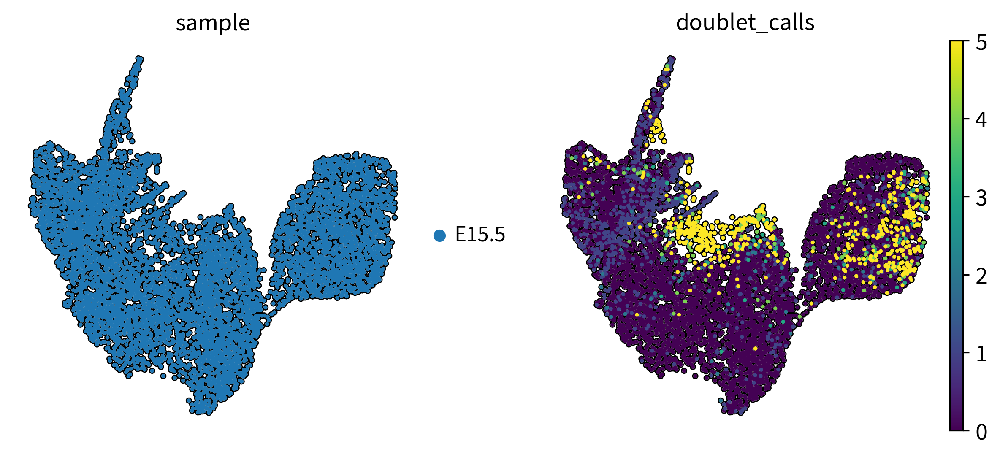

In [45]:
sc.pl.umap(adata, color=['sample','doublet_calls'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

In [46]:
# Number of calls
print(adata.obs['doublet_calls'].value_counts())

0    6186
1     764
5     546
4     112
3      88
2      88
Name: doublet_calls, dtype: int64


In [47]:
adata.obs.loc[:,'final_doublets'] = False
adata.obs.loc[adata.obs.loc[:,'doublet_calls'] > 3,'final_doublets'] = True

In [48]:
adata.obs['final_doublets_cat'] = adata.obs['final_doublets'].astype(str).astype('category')

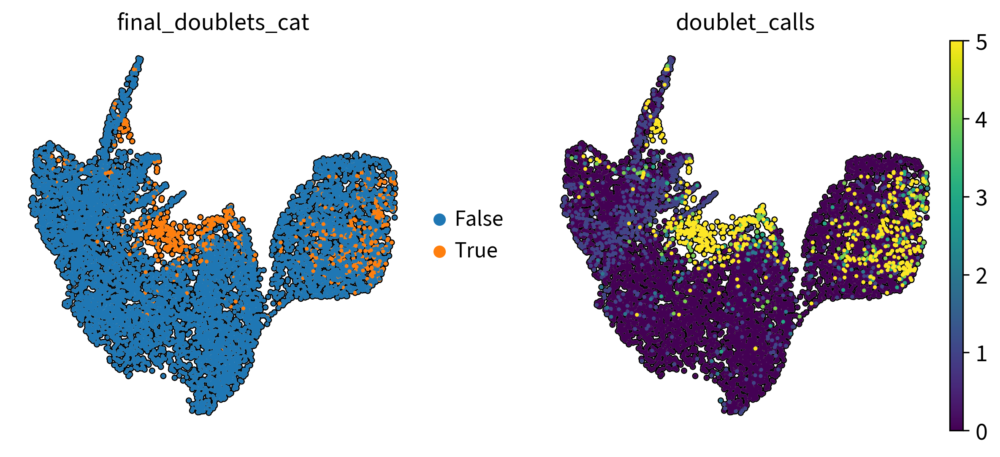

In [49]:
sc.pl.umap(adata, color=['final_doublets_cat','doublet_calls'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

In [50]:
# Number of final doublets
print('Number of doublets:')
print(adata.obs['final_doublets'].value_counts())

# Percentage:
print('\nOverall doublet rate: ',adata.obs['final_doublets'].value_counts()[1]/len(adata.obs['final_doublets'])*100,'%')

Number of doublets:
False    7126
True      658
Name: final_doublets, dtype: int64

Overall doublet rate:  8.453237410071942 %


In [51]:
# Annotate the data sets
print(adata.obs['sample'].value_counts())

# Checking the total size of the data set
adata.shape

E15.5    7784
Name: sample, dtype: int64


(7784, 24784)

In [52]:
# Copy results to multimodal anndata file
adata_multi.obs.loc[:,['doublet_calls','final_doublets','final_doublets_cat']] = adata.obs.loc[:,['doublet_calls','final_doublets','final_doublets_cat']]

In [53]:
# for R
doublet_calls = adata.obs.loc[:,['doublet_calls','final_doublets','final_doublets_cat']]

In [54]:
%%R -i doublet_calls

# read data
seurat <- readRDS("/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered_seurat.rds")

# add doublets to meta data
seurat <- AddMetaData(seurat,doublet_calls)

# save seurat file
saveRDS(seurat, "/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered_seurat_markedDoublets.rds")

# Save

In [55]:
# Save
sc.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered_markedDoublets.h5ad', adata_multi)
sc.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_gex_bc_matrix_filtered_markedDoublets.h5ad', adata)
sc.write('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E15-5_raw_gex_bc_matrix_filtered_markedDoublets.h5ad', adata)